# Part A. 재구매 유형 분리 로직 개발

# 0. Imort library

In [1]:
import numpy as np
import pandas as pd 

import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.dates as mdates

import plotly.express as px
import plotly.graph_objects as go
import plotly.offline as py
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import plotly.io as pio
pio.renderers.default = 'notebook_connected'

from datetime import date, timedelta

import warnings
warnings.filterwarnings("ignore")

from IPython.display import Image

# 1. Load Data

In [2]:
data_client = pd.read_csv("'21년 해카톤_고객정보.csv", encoding='cp949')
data_contact = pd.read_csv("'21년 해카톤_접촉정보.csv", encoding='cp949')
data_car = pd.read_csv("'21년 해카톤_차량정보.csv", encoding='cp949')

data_client.rename(columns={'CUS_ID':'고객ID', 'PSN_BIZR_YN':'개인사업자여부', 'SEX_SCN_NM':'성별', 'TYMD':'생년월', 'CUS_ADM_TRY_NM':'주소_행정시도명', 'CUS_N_ADMZ_NM':'주소_시군구명', 'CUS_ADMB_NM':'주소_행정동명', 'CLB_HOUS_PYG_NM':'주택 평형', 'REAI_BZTC_AVG_PCE':'주택 평균가격'}, inplace=True)
data_contact.rename(columns={'CNTC_SN':'접촉일련번호', 'CUS_ID':'고객ID', 'CNTC_DT':'접촉일자', 'CNTC_CHAN_NM':'접촉채널명', 'CNTC_AFFR_SCN_NM':'접촉업무명'}, inplace=True)
data_car.rename(columns={'CAR_ID':'차량ID', 'CUS_ID':'고객ID', 'WHOT_DT':'출고일자', 'CAR_HLDG_STRT_DT':'보유시작일자', 'CAR_HLDG_FNH_DT':'보유종료일자', 'CAR_NM':'차명', 'CAR_CGRD_NM_1':'차량등급명1', 'CAR_CGRD_NM_2':'차량등급명2', 'CAR_ENG_NM':'엔진타입명', 'CAR_TRIM_NM':'트림명'}, inplace=True)

현대자동차 제공데이터인 **고객정보, 접촉정보, 차량정보** 데이터를 불러왔습니다. 직관적인 해석을 위해 column명을 모두 한글로 변경했습니다.

# 2. Data Pre-Processing

### 1) 고객정보: data_client

In [3]:
# NA값 치환
data_client['개인사업자여부'] = data_client['개인사업자여부'].fillna('N')
data_client['주소_행정시도명'] = data_client['주소_행정시도명'].fillna("")
data_client['주소_시군구명'] = data_client['주소_시군구명'].fillna("")
data_client['주소_행정동명'] = data_client['주소_행정동명'].fillna("")

# 연령변수 생성
data_client['생년월'] = data_client['생년월'].astype(str)
data_client['출생연도'] = data_client['생년월'].str[:4].astype(int)
data_client['연령'] = 2021 - data_client['출생연도']

# 주소컬럼 병합
data_client['주소'] = data_client['주소_행정시도명'] + " " + data_client['주소_시군구명'] + " " + data_client['주소_행정동명']
data_client.drop(columns = ['생년월', '출생연도', '주소_행정시도명', '주소_시군구명', '주소_행정동명'], inplace = True)

먼저 **고객정보** 데이터입니다. **개인사업자여부, 주소** column의 NA값을 분석이 용이하도록 각각 fillna 해주었고, **생년월 및 출생연도** column을 활용하여 **고객의 연령**을 알 수 있는 column을 생성했습니다. 또한 3단계로 나뉘어진 주소를 하나의 column으로 병합했습니다. 마지막으로 분석에 활용할 column만 남기고 나머지 column은 모두 drop했습니다.

### 2) 접촉일자: data_contact

In [4]:
# 접촉일자 type 변경
data_contact['접촉일자'] = pd.to_datetime(data_contact['접촉일자'], format='%Y%m%d')

두번째로 **접촉정보** 데이터입니다. object type으로 되어있는 **접촉일자** column을 datetime으로 변경했습니다.

### 3) 차량정보: data_car

In [5]:
# 보유종료일자 NaN 처리
data_car['보유종료일자'] = data_car['보유종료일자'].fillna(20210614.0)

# 출고일자, 보유시작일자, 보유종료일자 type 변경
data_car['출고일자'] = pd.to_datetime(data_car['출고일자'], format='%Y%m%d')
data_car['보유시작일자'] = pd.to_datetime(data_car['보유시작일자'], format='%Y%m%d')
data_car['보유종료일자'] = pd.to_datetime(data_car['보유종료일자'], format='%Y%m%d')

# 출고~보유, 보유일 파생변수 생성
data_car['출고_보유시작'] = data_car['보유시작일자'] - data_car['출고일자']
data_car['보유시작_보유종료'] = data_car['보유종료일자'] - data_car['보유시작일자']
data_car['출고_보유종료'] = data_car['보유종료일자'] - data_car['출고일자']

# 한 고객이 한 차량만 거래한 경우 제외
# 고객ID별 차량ID 개수 count
data_car_count = pd.DataFrame(data_car.groupby('고객ID').count())
data_car_count.reset_index(inplace=True)
data_car_count = data_car_count[['고객ID', '차량ID']]

# 기존 데이터와 고객ID 기준 병합
data_car_not1 = pd.merge(data_car, data_car_count, on='고객ID', how='inner')

# 차량ID count가 1이 아닌 데이터만 추출 
data_car_not1 = data_car_not1[data_car_not1['차량ID_y'] != 1]
data_car_not1.rename(columns={'차량ID_y':'거래차량대수', '차량ID_x':'차량ID'}, inplace=True)

마지막으로 **차량정보** 데이터입니다. 파생변수를 생성하기 위해 보유종료일자 column의 NA값에 현재날짜로 fillna 했습니다. 그리고 **출고일자, 보유시작일자, 보유종료일자** column의 type을 datetime으로 변경했습니다. 이를 통해 파생변수를 생성했습니다. <br><br>
>**출고_보유시작**: 보유시작일자 - 출고일자<br>
>**보유시작_보유종료**: 보유종료일자 - 보유시작일자<br>
>**출고_보유종료**: 보유종료일자 - 출고일자<br>

또한 대차/추가구매 고객을 분리하는 로직을 개발하는데 차량구매건수가 1건인 고객은 분석에 포함하지 않는 것이 바람직하다고 판단하여 **고객별 거래차량대수** column을 생성하고 건수가 1건인 고객 데이터를 제외하였습니다.

# 3. 재구매 유형 분리/추정 로직 개발

### 1) Small EDA

In [6]:
data_car_mean = data_car_not1.groupby(['고객ID', '출고일자', '보유시작일자', '보유종료일자']).mean().reset_index()
data_car_mean['거래차량대수'].value_counts()

2     1003894
3      246840
4       63218
5       19149
6        6512
7        2271
8        1359
9         606
10        382
11        259
12        203
Name: 거래차량대수, dtype: int64

**차량정보** 데이터에서 **고객ID, 출고일자, 보유시작일자, 보유종료일자** 기준으로 groupby하여 데이터를 정렬하고, **거래차량대수** column을 value count하여 분포를 확인했습니다. 그 결과 거래차량대수가 2대인 고객이 100만건으로 가장 많았습니다.<br><br> 주고객의 재구매 경향을 분석하여 최적합 차량을 제공한다는 분석목표와 더불어 제한적인 개발환경을 고려하여, **고객별 거래차량대수가 2대**인 데이터만을 분석에 활용하였습니다.

### 2) 분석 DataFrame 및 '대차/추가구매 소요기간' column 생성

In [7]:
# 거래차량대수가 2대인 데이터만 추출
data_car_2 = data_car_mean[data_car_mean['거래차량대수'] == 2]

# 홀수행, 짝수행 기준으로 기존차량/다음차량 분리
data_다음차량 = data_car_2[1::2]
data_기존차량 = data_car_2[::2]

# 다음차량의 출고일자에서 기존차량의 출고일자를 빼서 대차/추가구매 소요기간 계산
data_diff = data_다음차량['출고일자'].reset_index() - data_기존차량['출고일자'].reset_index()

# column merge를 위해 index 맞추기
data_다음차량 = data_다음차량.set_index('고객ID')
data_다음차량.reset_index(inplace=True)

# column merge
data_다음차량['대차/추가구매 소요기간'] = data_diff['출고일자']

고객ID, 출고일자, 보유시작일자, 보유종료일자별로 정렬한 **data_car_mean**데이터에서 거래차량대수가 2대인 데이터만 추출하고,<br> 홀수행과 짝수행 기준으로 분리하여 **기존차량거래 데이터프레임**과 **다음차량거래 데이터프레임**을 생성했습니다.<br><br>
다음차량거래 출고일자에서 기존차량거래 출고일자를 빼서 **대차/추가구매 소요기간** column을 생성했습니다. <br>그리고 다음차량거래 데이터프레임(data_다음차량)에 해당 column을 추가했습니다.

### 3) 평균보유일수 column 생성

In [8]:
from pandas.core.common import SettingWithCopyWarning
warnings.simplefilter(action="ignore", category=SettingWithCopyWarning)

# 거래차량대수가 2대인 데이터만 추출
data_car_only2 = data_car_not1[data_car_not1['거래차량대수'] == 2]
data_car_days = data_car_only2[['고객ID', '차량ID', '출고_보유시작', '보유시작_보유종료', '출고_보유종료']]

# datetime 변수를 연산가능한 int로 변경
data_car_days['출고_보유시작'] = data_car_days['출고_보유시작'].astype(str).str[:-5]
data_car_days['출고_보유시작'] = data_car_days['출고_보유시작'].astype(int)
data_car_days['보유시작_보유종료'] = data_car_days['보유시작_보유종료'].astype(str).str[:-5]
data_car_days['보유시작_보유종료'] = data_car_days['보유시작_보유종료'].astype(int)
data_car_days['출고_보유종료'] = data_car_days['출고_보유종료'].astype(str).str[:-5]
data_car_days['출고_보유종료'] = data_car_days['출고_보유종료'].astype(int)

# 고객ID로 groupby하여 평균보유일수 계산
data_car_days = pd.DataFrame(data_car_days.groupby(['고객ID']).mean())
data_car_days.reset_index(inplace=True)

다음으로 datetime type으로 되어있는 **출고_보유시작, 보유시작_보유종료, 출고_보유종료** column을 int type으로 변환하였습니다.<br> 이후 **고객ID**를 기준으로 groupby하여 카테고리별 평균보유일수를 계산했습니다. 이를 통해 고객별로 거래차량을 얼마나 오래 보유하고 있는지 파악할 수 있습니다.

### 4) 고객별 평균보유일수와 대차/추가구매 소요기간을 나타내는 DataFrame 생성

In [9]:
# 계산된 columns 고객ID 기준으로 병합
data_car_2_고객ID = data_car_2.groupby('고객ID').mean().reset_index()
data_car_2_고객ID = pd.merge(data_다음차량, data_car_2_고객ID, on='고객ID', how='inner')
data_car_2_고객ID = pd.merge(data_car_2_고객ID, data_car_days, on='고객ID', how='inner')

# datetime 변수를 연산가능한 int로 변경
data_car_2_고객ID['대차/추가구매 소요기간'] = data_car_2_고객ID['대차/추가구매 소요기간'].astype(str).str[:-5]
data_car_2_고객ID['대차/추가구매 소요기간'] = data_car_2_고객ID['대차/추가구매 소요기간'].astype(int)

# 대차/추가구매 구분을 위한 차이 column 생성
data_car_2_고객ID['대차/추가구매'] = data_car_2_고객ID['대차/추가구매 소요기간'] - data_car_2_고객ID['출고_보유종료']
data_car_2_고객ID['|대차/추가구매|'] = abs(data_car_2_고객ID['대차/추가구매 소요기간'] - data_car_2_고객ID['출고_보유종료'])

# 최종으로 분리에 활용할 데이터프레임 추출
data_car_all_time = data_car_2_고객ID[['고객ID', '대차/추가구매 소요기간', '출고_보유종료', '대차/추가구매', '|대차/추가구매|']]

'해카톤 과제설명서'의 대차/추가구매 기간 정의를 참고하여, 계산한 고객별 평균보유일수 columns(출고_보유종료, 보유시작_보유종료, 출고_보유시작) 중 **출고_보유종료**를 분리 로직에 활용하는 것이 적합하다고 판단하였습니다. 마찬가지로 과제설명서의 기간 정의를 참고하여, **대차/추가구매 소요기간**과 **출고_보유종료기간**의 차이를 계산하여 분리에 활용하는 것이 유의미할 것이라고 판단했습니다. 그리고 정교한 분리를 위해 차이의 실제값과 절대값을 모두 분석에 활용할 수 있도록 절댓값을 계산한 **|대차/추가구매|** column을 생성했습니다.<br><br>
따라서 고객별 **대차/추가구매 소요기간, 출고_보유종료, 대차/추가구매, |대차/추가구매|** 기간을 column으로 한 DataFrame을 분리에 활용할 최종 데이터프레임으로 선정하였습니다.

### 5) Small EDA

In [10]:
fig = go.Figure()
fig.add_trace(go.Box(y=data_car_all_time['대차/추가구매 소요기간'], name='대차/추가구매 소요기간',
                marker_color = 'indianred'))
fig.add_trace(go.Box(y=data_car_all_time['대차/추가구매'], name = '대차/추가구매',
                marker_color = 'lightseagreen'))
fig.add_trace(go.Box(y=data_car_all_time['|대차/추가구매|'], name = '|대차/추가구매|',
                marker_color = 'yellow'))
fig.add_trace(go.Box(y=data_car_all_time['출고_보유종료'], name = '출고_보유종료',
                marker_color = 'purple'))

fig.show()

In [11]:
대차추가구매_소요기간 = pd.DataFrame(data_car_all_time['대차/추가구매 소요기간'].agg(['count', 'mean', 'std', 'min', 'max']))
대차추가구매 = pd.DataFrame(data_car_all_time['대차/추가구매'].agg(['count', 'mean', 'std', 'min', 'max']))
대차추가구매_절댓값 = pd.DataFrame(data_car_all_time['|대차/추가구매|'].agg(['count', 'mean', 'std', 'min', 'max']))
출고_보유종료 = pd.DataFrame(data_car_all_time['출고_보유종료'].agg(['count', 'mean', 'std', 'min', 'max']))

pd.concat([대차추가구매_소요기간, 대차추가구매, 대차추가구매_절댓값, 출고_보유종료], axis=1)

,대차/추가구매 소요기간,대차/추가구매,|대차/추가구매|,출고_보유종료
count,501947.000000,501947.000000,501947.000000,501947.000000
mean,-718.231911,-3340.519517,3731.112219,2622.287606
std,2895.375147,3193.780656,2727.288328,1119.656477
min,-6567.000000,-13652.000000,0.000000,2.000000
max,6465.000000,5478.000000,13652.000000,7669.000000


위의 4가지 column의 특성을 파악한 결과, 값의 분포 범위가 넓고 **|대차/추가구매|, 출고_보유종료** column의 경우 이상치가 상당히 존재하고 있음을 알 수 있습니다.<br> 따라서 분리 알고리즘을 선택하고 정규화 방식을 선정할 때 이러한 특성을 반영해야 한다고 판단했습니다.

### 6) 군집 알고리즘 수행

>**ㄱ. 정규화**<br><br>
정교한 군집화를 위해 **RobustScaler**를 활용하여 정규화를 진행했습니다. RobustScaler는 중앙값과 IQR을 사용하여 스케일링을 하는 것으로, 아웃라이어의 영향을 최소화 해줍니다. 이는 StandardScaler와 비교했을 때 동일한 값을 더 넓게 분포시킵니다. 위의 Small EDA 결과에서 알 수 있듯이 고객데이터의 특성상 극단적인 값들이 존재하므로 본 분석에서는 RobustScaler가 더 적합하다고 생각하여 정규화를 진행하였습니다.

> **ㄴ. K-means Clustering**<br><br>
분리에 활용할 DataFrame의 column은 모두 **int type**입니다. 또한 정답 데이터셋(label)이 없는 데이터이기 때문에 군집을 위해서는 **비지도학습**을 수행해야 합니다. <br><br>
K-means Clustering은 모집단 또는 범주에 대한 사전 정보가 없을 때 주어진 관측값 사이의 거리를 측정함으로써 유사성을 이용하여 분석하는 기법입니다. 전체 데이터를 집단으로 그룹화하는데, 이를 통해 각 집단의 성격을 파악하여 데이터의 구조를 이해할 수 있습니다. K-means Clustering의 핵심은 새로운 데이터와 기존 데이터 간 유클리디언 거리가 최소가 되도록 분류하는 것입니다. 기존 데이터를 기준점으로 유클리디언 거리를 측정하고 거리가 최소화 되도록 K개의 군집으로 clustering 합니다. K-means Clustering은 간단한 알고리즘으로 짧은 시간에 계산이 가능하며 탐색적인 방법이므로 대용량 데이터에 적합합니다. 또한 거리를 기준으로 분류하기 때문에 수치형 데이터일때 더 높은 성능을 가지는 알고리즘 입니다.

![군집](군집.png)

*(이미지 출처 : https://opentutorials.org/course/4548/28942)*<br><br>
고객별 평균보유기간과 대차/추가구매기간을 활용하여 비슷한 특성을 가진 고객을 분류하기 위해서는 **군집화 알고리즘**을 활용해야 한다고 판단했으며, 정답 데이터셋이 없기 때문에 **비지도학습 군집 알고리즘**을 활용해야 한다고 판단했습니다.<br><br>
그 중에서도 현재 DataFrame의 특성(수치형)을 잘 반영하여 군집할 수 있는 **K-means Clustering**을 선정하여 **대차/추가구매** 데이터를 분리했습니다.

In [12]:
# 군집화 데이터프레임 생성
col = ['대차/추가구매 소요기간', '출고_보유종료', '|대차/추가구매|']

group_data = data_car_all_time[col]

# 로버스트 스케일 정규화
from sklearn import preprocessing
from scipy.stats import boxcox
group_data = group_data.values
group_data = preprocessing.robust_scale(group_data)

# 2개로 군집화
from sklearn.cluster import KMeans
group = KMeans(n_clusters = 2)
group.fit(group_data)

centroids = group.cluster_centers_ 
labels = group.labels_
data_car_all_time['label'] = labels

먼저 군집화에 사용할 column을 선택했습니다. 모델이 **기간** 관점으로 학습하도록 하기 위하여 절댓값이 아닌 **대차/추가구매** column은 제외하였습니다.<br><br>
그리고 Robust Scaler로 **정규화**를 한 뒤 K를 2로 설정하여 (대차 / 추가구매) **K-means Clustering**을 수행했습니다.
수행결과를 전체 데이터프레임(data_car_all_time)에 **label** column으로 추가하였습니다. 

### 7. 군집 결과 시각화 (2차원, 3차원)

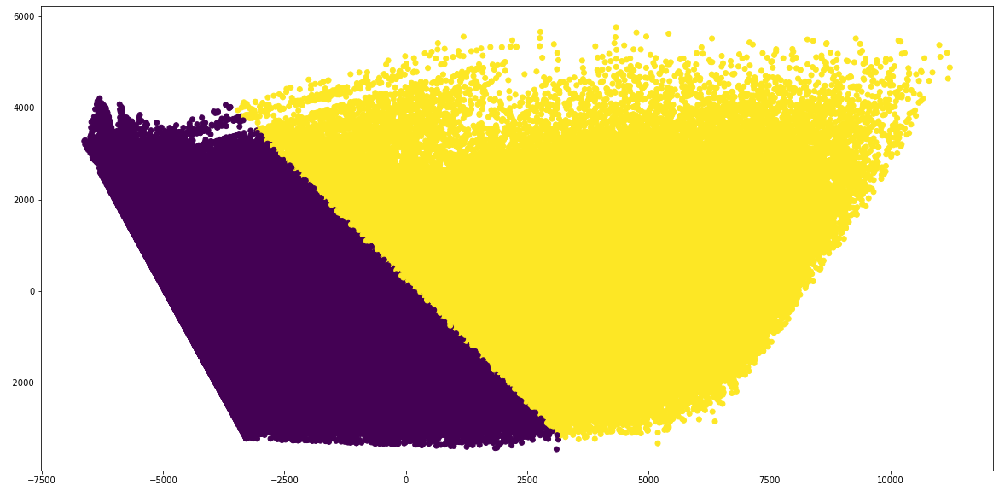

In [13]:
# 군집 시각화 (2차원)
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

data_2D = data_car_all_time[['대차/추가구매 소요기간', '출고_보유종료', '|대차/추가구매|']]
pca = PCA(n_components = 2)
fit = pca.fit_transform(data_2D)
pca_data = pd.DataFrame(data = fit, columns = ['PC1', 'PC2'])

plt.figure(figsize = (20,10))
plt.scatter('PC1', 'PC2', data = pca_data, c = data_car_all_time['label'])

display()

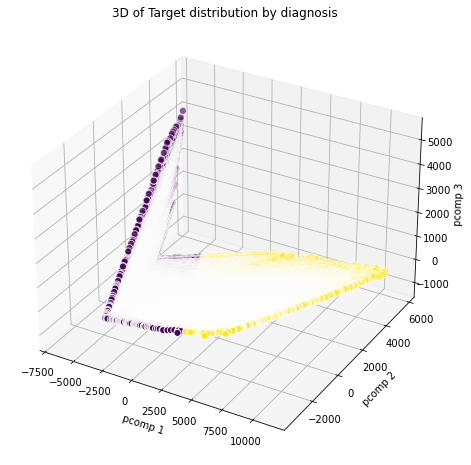

In [14]:
# 군집 시각화 (3차원)
pca3 = PCA(n_components=3)
data_pca3 = pca3.fit_transform(data_2D)

fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')
ax.scatter(data_pca3[:,0], data_pca3[:,1], data_pca3[:,2], c=data_car_all_time['label'], s=50, edgecolors='white')
ax.set_title('3D of Target distribution by diagnosis')
ax.set_xlabel('pcomp 1')
ax.set_ylabel('pcomp 2')
ax.set_zlabel('pcomp 3')

plt.show()

(*군집 결과 시각화는 다차원 데이터를 PCA(차원축소)하여 시각화한 결과이기 때문에 실제 데이터의 분포와는 차이가 있을 수 있습니다.)<br>

이상으로, 과제1의 **재구매 유형분리 로직개발** part를 완료했습니다. 이제 이를 바탕으로 EDA하여 대차 / 추가구매 데이터에 어떠한 유의미한 인사이트가 있을 지 분석하도록 하겠습니다.

# 4. EDA

### 1) 대차/추가구매 DataFrame 분리

In [15]:
# data_car에서 활용할 columns 추출
data_car_info = data_car[['고객ID', '차명', '차량등급명1', '차량등급명2', '엔진타입명', '트림명']]

# 고객ID 기준으로 병합
data_car_merge = pd.merge(data_car_info, data_car_all_time, on='고객ID', how='inner')
data_client_merge = pd.merge(data_client, data_car_all_time, on='고객ID', how='inner')
data_contact_merge = pd.merge(data_contact, data_car_all_time, on='고객ID', how='inner')

# 대차/추가구매 데이터 분리
data_car_merge_0 = data_car_merge[data_car_merge['label'] == 0]
data_car_merge_1 = data_car_merge[data_car_merge['label'] == 1]

data_client_merge_0 = data_client_merge[data_client_merge['label'] == 0]
data_client_merge_1 = data_client_merge[data_client_merge['label'] == 1]

data_contact_merge_0 = data_contact_merge[data_contact_merge['label'] == 0]
data_contact_merge_1 = data_contact_merge[data_contact_merge['label'] == 1]

위의 분석결과로 나뉜 **고객별 label(0, 1)** 을 기준으로 데이터를 분리했습니다.

### 2) Small EDA

In [16]:
fig = go.Figure()
fig.add_trace(go.Box(y=data_car_merge_0['|대차/추가구매|'], name='label 0',
                marker_color = 'indianred'))
fig.add_trace(go.Box(y=data_car_merge_1['|대차/추가구매|'], name = 'label 1',
                marker_color = 'lightseagreen'))

fig.show()

해카톤 과제정의서의 대차/추가구매 정의에 따르면 **대차**의 경우는 기존 보유하던 차량을 처분하고, 신차를 출고하는 경우로 대차 소요 기간과 보유 기간이 유사하며, 보유 기간이 대차 소요 기간 보다 길 수도 있습니다. **추가구매**의 경우는 기존 보유하던 차량을 처분하지 않고, 추가로 신차를 출고하는 경우로 보유 기간과 추가구매 소요 기간이 일정 수준의 차이를 보입니다.<br>

따라서, 대차/추가구매 기간이 더 긴 label 0의 데이터를 **추가구매**로, 대차/추가구매 기간이 더 짧은 label 1의 데이터를 **대차**로 선정했습니다.

In [19]:
# DataFrame 이름 변경
추가구매_고객정보 = data_client_merge_0
대차_고객정보 = data_client_merge_1

추가구매_접촉정보 = data_contact_merge_0
대차_접촉정보 = data_contact_merge_1

추가구매_차량 = data_car_merge_0
대차_차량 = data_car_merge_1

# Part B. 재구매 유형 예측모델 개발

# 0. Import library

In [20]:
# Classification
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import classification_report
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn import metrics
from sklearn.naive_bayes import GaussianNB
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, confusion_matrix, precision_score, recall_score, f1_score
from sklearn.svm import SVC

# Regression
import xgboost
from math import sqrt
from sklearn.metrics import mean_squared_error
import lightgbm as lgb
from catboost import CatBoostRegressor

# 1. Data Pre-Processing

### 1) 대차/추가구매 DataFrame 병합

In [22]:
# 대차/추가구매 데이터프레임 병합
# 고객정보
고객정보 = pd.concat([대차_고객정보, 추가구매_고객정보])
고객정보 = 고객정보[['고객ID', '개인사업자여부', '주택 평균가격', '성별', '대차/추가구매 소요기간', '출고_보유종료', '대차/추가구매', '|대차/추가구매|', 'label']]

# 접촉정보
대차_접촉정보 = 대차_접촉정보[['고객ID', '접촉채널명', '접촉업무명']]
추가구매_접촉정보 = 추가구매_접촉정보[['고객ID', '접촉채널명', '접촉업무명']]
접촉정보 = pd.concat([대차_접촉정보, 추가구매_접촉정보])
접촉건수 = 접촉정보.groupby('고객ID').count().reset_index()
접촉건수.rename(columns={'접촉채널명':'접촉건수'}, inplace=True)
접촉건수 = 접촉건수[['고객ID', '접촉건수']]

# 차량정보
대차_차량 = 대차_차량[['고객ID', '차명', '차량등급명1', '차량등급명2', '엔진타입명', '트림명']]
추가구매_차량 = 추가구매_차량[['고객ID', '차명', '차량등급명1', '차량등급명2', '엔진타입명', '트림명']]
차량정보 = pd.concat([대차_차량, 추가구매_차량])

**접촉정보** DataFrame의 경우, 고객ID별 접촉건수를 파악하여 분석에 활용하는 것이 유의미할 것이라고 판단하여 **접촉건수** column을 생성했습니다.

### 2) 예측모델을 위한 DataFrame 생성

In [24]:
merge_data = pd.merge(고객정보, 접촉건수, on='고객ID', how='inner')

**차량정보** 데이터의 경우, 모든 column이 **범주형**이며 차명, 차량등급명, 트림명 등 많은 경우의 수를 가진 DataFrame이기 때문에 예측모델을 학습시키기에 적합하지 않다고 판단되어 배제하였습니다. 따라서 **고객ID**를 기준으로 고객정보와 접촉건수 DataFrame을 병합하였습니다.

In [25]:
print("주택 평균가격 null 갯수 :", merge_data['주택 평균가격'].isnull().sum())
print("전체 데이터 갯수 :", len(merge_data))
print("null 비율 :", merge_data['주택 평균가격'].isnull().sum()/len(merge_data))

주택 평균가격 null 갯수 : 216032
전체 데이터 갯수 : 493812
null 비율 : 0.43747823058167884


**주택 평균가격** column의 경우, 데이터의 43%가량이 null값이기 때문에 분석에서 제외하였습니다.

In [26]:
# 최종 데이터프레임 생성
col = ['개인사업자여부', '성별', '대차/추가구매 소요기간', '출고_보유종료', '대차/추가구매', '|대차/추가구매|', '접촉건수']
input_data = merge_data[col]

# Categorical 변수 One-Hot Encoding
input_data = pd.get_dummies(input_data , columns=['개인사업자여부', '성별'])

분석에 활용할 최종 DataFrame을 생성하고, 범주형 변수(개인사업자여부, 성별)는 **one-hot-encoding**을 통해 분석에 적합한 형태로 만들었습니다.

### 3) 독립변수 / 종속변수 분리 & 학습데이터 / 검증데이터 분리

In [27]:
# 독립변수(x_data) / 종속변수(y_data) 분리
x_data = input_data
y_data = merge_data[['label']]

# 학습데이터(train) / 검증데이터(test) 분리 - 7:3
X_train, X_test, y_train, y_test = train_test_split(x_data, y_data, test_size=0.3, random_state=777, stratify=y_data)

**독립변수**는 label을 제외한 모든 변수이고, **종속변수**는 고객별 label값 입니다.<br>
분리한 독립변수, 종속변수 DataFrame을 **7:3** 비율로 학습데이터와 검증데이터로 분리했습니다.

# 2. 이진분류 예측모델 생성

예측모델은 고객별 대차/추가구매 가능성을 **이진분류** 하는 것을 목표로 하기 때문에 지도학습 분류(Classification) 알고리즘을 사용했습니다. Classification은 Supervised learning 지도학습의 일종으로 기존에 존재하는 데이터의 Category 관계를 파악하고, 새롭게 관측된 데이터의 Category를 스스로 판별하는 과정입니다. <br><br> 과제1에서 정답(label)이 없는 데이터셋을 비지도학습 Clustering 방식으로 분류했다면, 지금은 정답(label)이 있는 데이터이기 때문에 지도학습 기계학습 알고리즘을 사용하는 것이 적합하다고 판단하였습니다. <br><br> 예측모델은 여러 알고리즘을 같은 훈련 & 검증 데이터로 학습시키고 검증하여 **accuracy_score, precision_score, recall_score, f1_score**가 가장 높은 모델을 선정하는 방식으로 진행했습니다.

>* **랜덤포레스트**<br>
분류, 회귀 분석 등에 사용되는 앙상블 학습 방법의 일종으로, 훈련 과정에서 구성한 다수의 결정 트리로부터 부류(분류) 또는 평균 예측치(회귀 분석)를 출력함으로써 동작하는 알고리즘입니다.

>* **서포트벡터머신**<br>
결정 경계(Decision Boundary), 즉 분류를 위한 기준 선을 정의하는 알고리즘입니다. 따라서 분류되지 않은 새로운 점이 나타나면 경계의 어느 쪽에 속하는지 확인해서 분류 과제를 수행할 수 있게 됩니다.

>* **나이브베이즈**<br>
베이즈 이론(Bayes theorem)의 확률 모델을 기반으로 하는 강력한 분류기 알고리즘입니다. 기본적으로 각 속성값 확률을 기반으로 범주에 속한 인스턴스를 확률을 이용하여 분류합니다.

>* **KNN**<br>
데이터를 분류하고 새로운 데이터 포인트의 카테고리를 결정할 때 K개의 가장 가까운 포인트를 선점하고 그중 가장 많이 선택된 포인트의 카테고리로 이 새로운 데이터를 분류하는 알고리즘입니다.

>* **로지스틱회귀**<br>
회귀를 사용하여 데이터가 어떤 범주에 속할 확률을 0에서 1 사이의 값으로 예측하고 그 확률에 따라 가능성이 더 높은 범주에 속하는 것으로 분류해주는 지도 학습 알고리즘입니다.

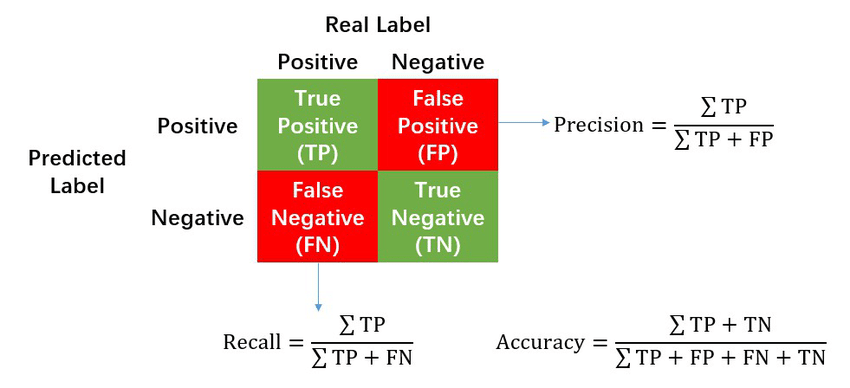

In [28]:
Image('정확도.png')

분류 알고리즘의 성능평가 지표로는 **정확도, 정밀도, 재현율, f1_score(정밀도와 재현율의 조화평균)** 을 이용했습니다. 알고리즘별 성능평가 지표를 비교한 후 지표들 가운데 가장 높은 값을 가지고 있는 모델을 선정했습니다. 

### 1) 분류 알고리즘 실행 및 검증

In [29]:
# RandomForest
model = RandomForestClassifier()
model.fit(X=X_train, y=y_train)

y_pred = model.predict(X = X_test)
y_true = y_test

rf_acc = accuracy_score(y_true, y_pred)
rf_pre = precision_score(y_true, y_pred)
rf_recall = recall_score(y_true, y_pred)
rf_f1 = f1_score(y_true, y_pred)


# 서포트벡터머신
model = SVC()
model.fit(X=X_train, y=y_train)

y_pred = model.predict(X_test)
y_true = y_test

svc_acc = accuracy_score(y_true, y_pred)
svc_pre = precision_score(y_true, y_pred)
svc_recall = recall_score(y_true, y_pred)
svc_f1 = f1_score(y_true, y_pred)


# 나이브베이즈
model = GaussianNB()
model.fit(X=X_train, y=y_train)

y_pred = model.predict(X_test)
y_true = y_test

nb_acc = accuracy_score(y_true, y_pred)
nb_pre = precision_score(y_true, y_pred)
nb_recall = recall_score(y_true, y_pred)
nb_f1 = f1_score(y_true, y_pred)


# KNN
knn = KNeighborsClassifier()
knn.fit(X_train, y_train)

y_pred = knn.predict(X_test)
y_true = y_test

knn_acc = accuracy_score(y_true, y_pred)
knn_pre = precision_score(y_true, y_pred)
knn_recall = recall_score(y_true, y_pred)
knn_f1 = f1_score(y_true, y_pred)


# LogisticRegression
log = LogisticRegression()
log.fit(X_train, y_train)

y_pred = log.predict(X_test)
y_true = y_test

LR_acc = accuracy_score(y_true, y_pred)
LR_pre = precision_score(y_true, y_pred)
LR_recall = recall_score(y_true, y_pred)
LR_f1 = f1_score(y_true, y_pred)

### 2) Confusion Matrix (혼동행렬)

In [30]:
confusion_matrix(y_true, y_pred)

array([[81112,   434],
       [  314, 66284]])

### 3) 알고리즘별 성능평가 지표 시각화

In [31]:
# 모델별 accuracy_score 점수 DataFrame 생성
accuracy = pd.DataFrame([rf_acc, svc_acc, nb_acc, knn_acc, LR_acc], columns=['accuracy'], index=['랜덤포레스트', '서포트벡터머신', '나이브베이즈', 'KNN', '로지스틱회귀'])
accuracy.sort_values(by=['accuracy'], axis=0, ascending=False, inplace=True)

# 모델별 accuracy_score 시각화
colors = ['lightslategray',] * 5
colors[0] = 'crimson'

fig = go.Figure(go.Bar(x=accuracy.index, y=accuracy['accuracy'], marker_color=colors))
fig.update_layout(title_text='Accuracy Score')

In [32]:
# 모델별 precision_score 점수 DataFrame 생성
precision = pd.DataFrame([rf_pre, svc_pre, nb_pre, knn_pre, LR_pre], columns=['precision'], index=['랜덤포레스트', '서포트벡터머신', '나이브베이즈', 'KNN', '로지스틱회귀'])
precision.sort_values(by=['precision'], axis=0, ascending=False, inplace=True)

# 모델별 precision_score 시각화
colors = ['lightslategray',] * 5
colors[0] = 'crimson'

fig = go.Figure(go.Bar(x=precision.index, y=precision['precision'], marker_color=colors))
fig.update_layout(title_text='Precision Score')

In [33]:
# 모델별 recall_score 점수 DataFrame 생성
recall = pd.DataFrame([rf_recall, svc_recall, nb_recall, knn_recall, LR_recall], columns=['recall'], index=['랜덤포레스트', '서포트벡터머신', '나이브베이즈', 'KNN', '로지스틱회귀'])
recall.sort_values(by=['recall'], axis=0, ascending=False, inplace=True)

# 모델별 recall_score 시각화
colors = ['lightslategray',] * 5
colors[0] = 'crimson'

fig = go.Figure(go.Bar(x=recall.index, y=recall['recall'], marker_color=colors))
fig.update_layout(title_text='Recall Score')

In [34]:
# 모델별 fl_score 점수 DataFrame 생성
fl_score = pd.DataFrame([rf_f1, svc_f1, nb_f1, knn_f1, LR_f1], columns=['fl_score'], index=['랜덤포레스트', '서포트벡터머신', '나이브베이즈', 'KNN', '로지스틱회귀'])
fl_score.sort_values(by=['fl_score'], axis=0, ascending=False, inplace=True)

# 모델별 fl_score 시각화
colors = ['lightslategray',] * 5
colors[0] = 'crimson'

fig = go.Figure(go.Bar(x=fl_score.index, y=fl_score['fl_score'], marker_color=colors))
fig.update_layout(title_text='F1 Score')

위 결과를 바탕으로 성능지표 모두에서 1위를 한 **서포트벡터머신(SVM)** 을 최종 예측모델로 선정하였습니다.

# 3. 변수중요도 확인

나아가, label 값에 어떠한 변수들이 얼만큼의 영향을 미쳤는가를 파악하기 위해 **회귀분석 알고리즘**을 실행했습니다. 독립변수는 label을 제외한 모든 변수이며 종속변수는 label 값입니다.<br><br>
사용한 알고리즘은 그래디언트 부스팅에 해당하는 **XGBoost, LightGBM, CatBoost** 입니다. 그래디언트 부스팅은 회귀 및 분류 문제에 대한 기계 학습 기술로, 약한 예측 모델, 일반적으로 의사 결정 트리의 앙상블 형태로 예측 모델을 생성합니다. 다른 부스팅 방법과 마찬가지로 단계적으로 모델을 빌드하고 임의의 차별화 가능한 손실 함수를 최적화하여 모델을 일반화합니다.

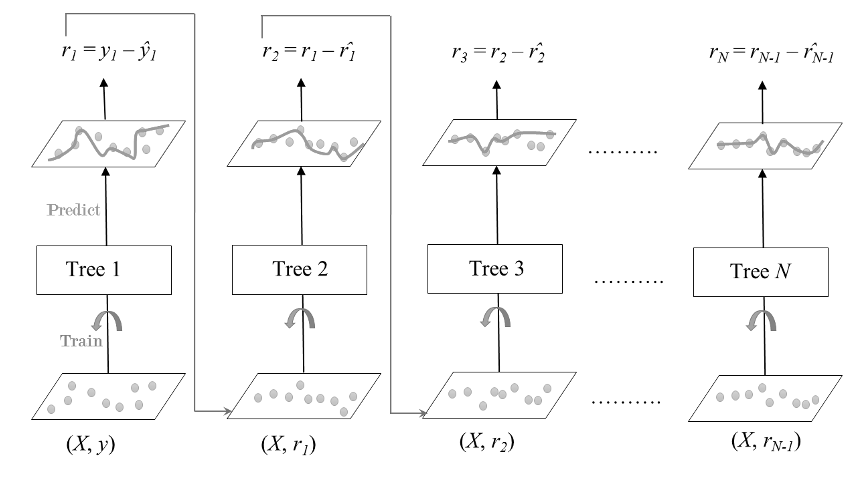

In [35]:
Image('그래디언트.png')

### 1) 회귀분석 알고리즘 선정

각 알고리즘의 **RMSE(평균 제곱근 오차)**를 비교하여 RMSE가 가장 낮은 모델을 선정하여 변수중요도를 파악하였습니다.

In [36]:
# XGBRegressor
liner_model = xgboost.XGBRegressor() 
liner_model.fit(X_train, y_train)
liner_model_predict = liner_model.predict(X_test)
XGBRegressor_RMSE = sqrt(mean_squared_error(liner_model_predict, y_test))

# lightgbm
lgb_dtrain = lgb.Dataset(data = X_train, label = y_train)
lgb_param = {'max_depth': 10,
            'learning_rate': 0.01,
            'n_estimators': 1000,
            'objective': 'regression'}
lgb_model = lgb.train(params = lgb_param, train_set = lgb_dtrain)
lgb_model_predict = lgb_model.predict(X_test)
lightgbm_RMSE = sqrt(mean_squared_error(lgb_model_predict, y_test))

# CatBoostRegressor
cb_model = CatBoostRegressor(iterations=1000, learning_rate=0.1, depth=4, l2_leaf_reg=20, bootstrap_type='Bernoulli', subsample=0.6, eval_metric='RMSE', metric_period=50, od_type='Iter', od_wait=45, random_seed=17, allow_writing_files=False) 
cb_model.fit(X_train, y_train) 
cb_model_predict = cb_model.predict(X_test)
CatBoostRegressor_RMSE = sqrt(mean_squared_error(cb_model_predict, y_test))

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013544 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1281
[LightGBM] [Info] Number of data points in the train set: 345668, number of used features: 9
[LightGBM] [Info] Start training from score 0.449547
0:	learn: 0.4510388	total: 74.4ms	remaining: 1m 14s
50:	learn: 0.0733651	total: 684ms	remaining: 12.7s
100:	learn: 0.0623786	total: 1.31s	remaining: 11.7s
150:	learn: 0.0570042	total: 1.84s	remaining: 10.3s
200:	learn: 0.0534258	total: 2.37s	remaining

In [37]:
# 모델별 RMSE DataFrame 생성
RMSE = pd.DataFrame([XGBRegressor_RMSE, lightgbm_RMSE, CatBoostRegressor_RMSE], columns=['RMSE'], index=['XGBRegressor', 'lightgbm', 'CatBoostRegressor'])
RMSE.sort_values(by=['RMSE'], axis=0, ascending=False, inplace=True)

# 모델별 RMSE 시각화
colors = ['lightslategray',] * 5
colors[2] = 'crimson'

fig = go.Figure(go.Bar(x=RMSE.index, y=RMSE['RMSE'], marker_color=colors))
fig.update_layout(title_text='RMSE')

분석 결과, **XGBRegressor**의 RMSE가 가장 낮기 때문에 해당 알고리즘을 사용하여 변수의 영향도를 파악했습니다.

### 2. SHAP 시각화

변수의 중요도를 파악하기 위해 **SHAP**를 활용하여 시각화하였습니다. SHAP(SHAPley Additional exPlanations)는 개별 예측을 설명합니다. SHAP는 최적의 shapely 값을 이론적으로 한 게임을 기반으로 하여 기계학습을 해석하고 설명할 수 있도록 만들어진 방식입니다.

In [38]:
import shap
explainer = shap.TreeExplainer(liner_model)
shap_values = explainer.shap_values(X_test)

XGBRegressor model을 shap tree model에 지정한 후 Shap values를 계산합니다.

* **SHAP Summary Plot**

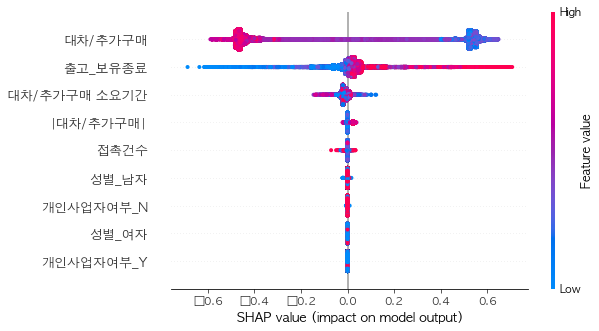

In [40]:
plt.rcParams['font.family'] = 'AppleGothic'
shap.summary_plot(shap_values, X_test)

이 그래프는 모든 변수들의 shap value를 요약한 것입니다. 해당 변수가 **빨간색**을 띄면 target에 대해 **양의 영향력**이 존재하는 것이고, **파란색**을 띄면 **음의 영향**이 존재하는 것입니다.

> **대차/추가구매** : 값이 높을 수록 1에 가까운 경향이 있다. (대차에 가까워진다.)<br>
> **출고_보유종료** : 값이 높을 수록 0에 가까운 경향이 있다. (추가구매에 가까워진다.)

*(나머지 변수는 특이점 없음)*

* **SHAP Feature Importance**

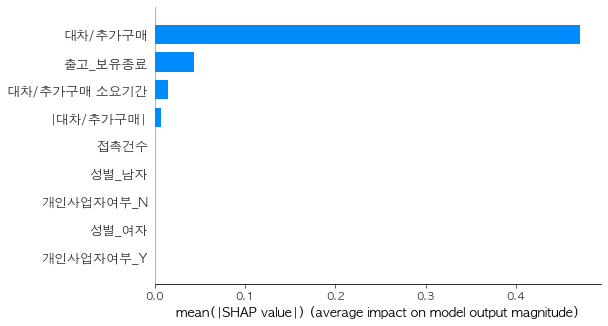

In [41]:
# 각 변수에 대한 |Shap Values|을 통해 변수 importance 파악
plt.rcParams['font.family'] = 'AppleGothic'
shap.summary_plot(shap_values, X_test, plot_type = "bar")

이 그래프는 각 변수의 shap value에 절댓값을 취한 것으로 **변수의 평균적인 영향력**을 보여줍니다. 큰 영향력을 보일 수록 target과의 관계성이 크다는 것을 뜻합니다. (변수 중요도와 비슷한 개념)<br>

> **대차/추가구매** > **출고_보유종료** > **대차/추가구매 소요기간** 순으로 영향력이 큰 것을 알 수 있다.

* **SHAP Dependency Plot**

아래 그래프들은 **변수간 의존성**을 보여주는 shap value 입니다.

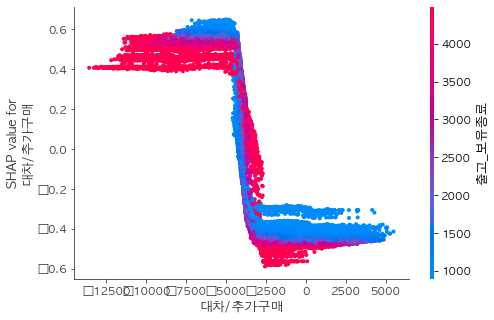

In [42]:
# 대차/추가구매
plt.rcParams['font.family'] = 'AppleGothic'
shap.dependence_plot("대차/추가구매", shap_values, X_test)

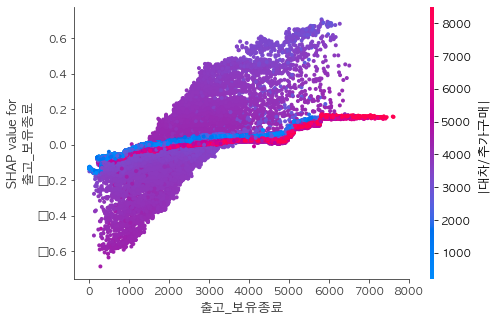

In [43]:
# 출고_보유종료
plt.rcParams['font.family'] = 'AppleGothic'
shap.dependence_plot("출고_보유종료", shap_values, X_test)

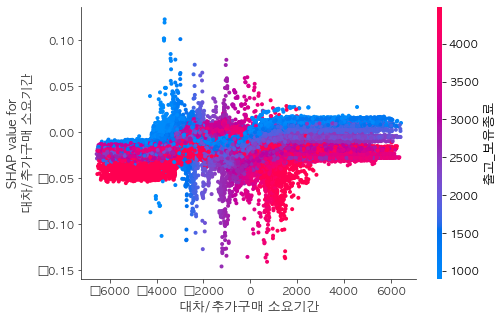

In [44]:
# 대차/추가구매 소요기간
plt.rcParams['font.family'] = 'AppleGothic'
shap.dependence_plot("대차/추가구매 소요기간", shap_values, X_test)

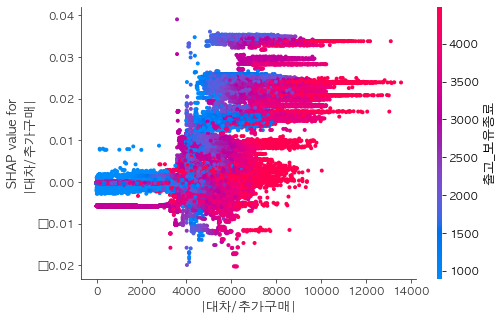

In [45]:
# |대차/추가구매|
plt.rcParams['font.family'] = 'AppleGothic'
shap.dependence_plot("|대차/추가구매|", shap_values, X_test)

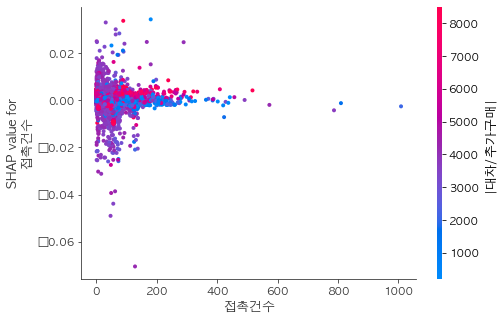

In [46]:
# 접촉건수
plt.rcParams['font.family'] = 'AppleGothic'
shap.dependence_plot("접촉건수", shap_values, X_test)